# Description

This code is the reworked version of the original. it aims to do the cluster analysis for proteins and DNA group, as well as both simulatineoulsy and output it into a directory in csv format for furhter analyis.

In [ ]:
# Run if you want to get rid of water, leave only protein and make the molecules whole
!mkdir vars
# supply the index to be able to select the group that is both proteins and RNA
! echo 16 | gmx trjconv -f ../dynamic.xtc -s ../dynamic.tpr -o vars/output_no_water.xtc -pbc mol # make the molecules whole again!
! echo 16 | gmx trjconv -f ../dynamic.gro -s ../dynamic.tpr -o vars/output_no_water.gro -pbc mol

cat: write error: Broken pipe
               :-) GROMACS - gmx trjconv, 2024.2-conda_forge (-:

Executable:   /opt/conda/envs/gromacs/bin.AVX2_256/gmx
Data prefix:  /opt/conda/envs/gromacs
Working dir:  /home/alexeyk/Desktop/simulations/Finished/serf_peg/MDanal
Command line:
  gmx trjconv -f ../dynamic.xtc -s ../dynamic.tpr -o vars/output_no_water.xtc -pbc mol

Note that major changes are planned in future for trjconv, to improve usability and utility.
Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../dynamic.tpr, VERSION 2024.2-conda_forge (single precision)
Reading file ../dynamic.tpr, VERSION 2024.2-conda_forge (single precision)
Select group for output
Group     0 (         System) has 230186 elements
Group     1 (        Protein) has  6450 elements
Group     2 (      Protein-H) has  6450 elements
Group     3 (        C-alpha) has     0 elements
Group     4 (       Backbone) has     0 elements
Group     5 (      MainChain) has     0 elements
Group    

In [1]:

import MDAnalysis as mda
import numpy as np
# Load the simulation files

u= mda.Universe("vars/output_no_water.gro", "vars/output_no_water.xtc")
# test with unwrapped
#u= mda.Universe("unwrapped_no_water.gro", "unwrapped_no_water.xtc")

NUM_RES = 59
NUM_PROTEINS = 50
PROTEIN_LEN = 129
RNA_LEN = 24 # indicates the rna length
NUM_RNA = 50
NUM_RES_RNA = 159 #how many beads in one rna
rna_start = NUM_PROTEINS * PROTEIN_LEN
print(rna_start) # gives the start of the RNA section

proteins = []

# this selects all 50 atoms
for i in range(NUM_PROTEINS):
    max_atoms = NUM_PROTEINS * PROTEIN_LEN
    start_index = i * PROTEIN_LEN + 1
    end_index = (i + 1) * PROTEIN_LEN
    proteins.append(u.select_atoms(f"bynum {start_index}:{end_index}"))

coms = [] #array that will contain centers of mass
for ts in u.trajectory:
    frame_coms = np.array([protein.center_of_mass() for protein in proteins])
    coms.append(frame_coms)
coms = np.array(coms)
print(coms.shape)
print(proteins)
    




/opt/conda/envs/gromacs/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/opt/conda/envs/gromacs/lib/python3.12/site-packages/MDAnalysis/coordinates/XDR.py:240: UserWarning: Reload offsets from trajectory
 ctime or size or n_atoms did not match
  warnings.warn("Reload offsets from trajectory\n "


6450
(20001, 50, 3)
[<AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>, <AtomGroup with 129 atoms>,

In [2]:
from MDAnalysis.analysis import contacts
from MDAnalysis.analysis import distances
from MDAnalysis.analysis.rms import rmsd
def get_minimal_distance(u, group_a, group_b):
    # Preallocate arrays
    com_dist = []
    for i, ts in enumerate(u.trajectory):
        res_com1 = group_a.center_of_mass(compound='residues')
        res_com2 = group_b.center_of_mass(compound='residues')
         
        com_dist.append(np.min(distances.distance_array(res_com1, res_com2,
                                    box=u.dimensions)))
    return com_dist

# calculate distances between each pair of residues (taken from different groups)
def get_distances(u, group_a, group_b):
    # Preallocate arrays
    com_dist = []
    for i, ts in enumerate(u.trajectory):
        res_com1 = group_a.center_of_mass(compound='residues')
        res_com2 = group_b.center_of_mass(compound='residues')
         
        com_dist.append(np.mean(distances.distance_array(res_com1, res_com2,
                                    box=u.dimensions)))
    return com_dist

# def calculate_rmsd(u, group_a, group_b):
#     num_frames = len(u.trajectory)
#     rmsd_frames = np.zeros([num_frames])
#     for i, ts in enumerate(u.trajectory):
#         rmsd_frames[i] = rmsd(group_a.center_of_mass(compound='residues'), group_b.center_of_mass(compound='residues'))
#     return rmsd_frames

In [3]:
from joblib import Parallel, delayed
import numpy as np
# dist_1_2 = get_distances(u, proteins[1], proteins[2])
# rmsd12 = calculate_rmsd(u, proteins[1], proteins[2])
# print(dist_1_2.shape)
# print(rmsd12.shape)
def compute_rmsd_for_parallel(i, j):
    u= mda.Universe("vars/output_no_water.gro", "vars/output_no_water.xtc")
    group_a = u.select_atoms(f"bynum {i * PROTEIN_LEN + 1}:{(i + 1) * PROTEIN_LEN}")
    group_b = u.select_atoms(f"bynum {j * PROTEIN_LEN + 1}:{(j + 1) * PROTEIN_LEN}")
    #return (i, j, calculate_rmsd(u, group_a, group_b))
    #return (i, j, get_distances(u, group_a, group_b))
    return (i, j, get_minimal_distance(u, group_a, group_b))



    

# for i in range(NUM_PROTEINS):
#     for j in range(i, NUM_PROTEINS):
#         rmsd_ij = calculate_rmsd(u, proteins[i], proteins[j])
def parallel_rmsd_calculation(num_proteins):
    """Parallel computation of RMSD for all pairs of proteins across all frames."""
    num_frames = len(u.trajectory)
    rmsd_3d = np.zeros((num_frames, num_proteins, num_proteins))
    results = Parallel(n_jobs=32)(
        delayed(compute_rmsd_for_parallel)(i, j)
        for i in range(num_proteins)
        for j in range(i, num_proteins)
    )
    # Populate the 3D array
    for i, j, rmsd_frames in results:
        rmsd_3d[:, i, j] = rmsd_frames  # Upper triangle
        rmsd_3d[:, j, i] = rmsd_frames  # Symmetric lower triangle
    
    return rmsd_3d     
        
rmsd_3d_array = parallel_rmsd_calculation(NUM_PROTEINS)
print(rmsd_3d_array.shape)
np.save("vars/rmsd_3d_array.npy", rmsd_3d_array)

SystemExit: 1

/opt/conda/envs/gromacs/lib/python3.12/site-packages/IPython/core/interactiveshell.py:3585: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [6]:
import networkx as nx
import numpy as np

# this is so you don't have to recompute over and over
rmsd_3d_array = np.load("vars/rmsd_3d_array.npy")

def graph_based_clustering(rmsd_matrix, cutoff):
    """
    Perform graph-based clustering for a single frame.
    Nodes are connected if RMSD is below the cutoff.
    """
    num_proteins = rmsd_matrix.shape[0]
    G = nx.Graph()

    # Add nodes
    G.add_nodes_from(range(num_proteins))

    # Add edges for pairs below the cutoff
    for i in range(num_proteins):
        for j in range(i + 1, num_proteins):
            if rmsd_matrix[i, j] < cutoff:
                G.add_edge(i, j)

    # Find connected components (clusters)
    clusters = [list(component) for component in nx.connected_components(G)]
    return clusters

# min clustsize allows to set the minimal size that counts as a cluster
def cluster_all_frames(rmsd_3d, cutoff, min_clust_size=0):
    """
    Perform clustering for each frame in the trajectory.
    """
    num_frames = rmsd_3d.shape[0]
    clusters_per_frame = {}

    for frame_idx in range(num_frames):
        rmsd_matrix = rmsd_3d[frame_idx]
        clusters = graph_based_clustering(rmsd_matrix, cutoff)
        if len(clusters) >= min_clust_size:
            clusters_per_frame[frame_idx] = clusters

    return clusters_per_frame

In [ ]:
# # Example usage
# cutoff_value = 5.0  # Adjust as needed
# clusters_per_frame = cluster_all_frames(rmsd_3d_array, cutoff_value)

# # Print clusters for the first few frames
# for frame, clusters in list(clusters_per_frame.items()):
#     print(f"Frame {frame}: {len(clusters)}")

In [7]:
cutoffs = [10, 15, 20, 25, 30]
clusts = []
for cutoff in cutoffs:
    clusts.append(cluster_all_frames(rmsd_3d_array, cutoff))

In [8]:
import matplotlib.pyplot as plt

# This function is for plotting clusterizations
def plot_cluster(clusters_per_frame, cutoff, n):
    num_clusters = [len(clusters) for clusters in clusters_per_frame.values()]
    plt.figure(figsize=(12, 6))
    plt.plot(range(len(num_clusters)), num_clusters,label='Number of Clusters', marker='o', markersize=4)
    plt.xlabel("Frame")
    plt.ylabel("Number of Clusters")
    plt.title(f"Number of Clusters Per Frame. Cutoff ={cutoff}A")
    plt.legend()
    plt.show

    average_cluster_sizes = []
    frames = []

    # increase n to average over frames and reduce noise
    avg_over_n = 0
    for frame, clusters in clusters_per_frame.items():
        total_size = sum(len(cluster) for cluster in clusters)
        avg_size = total_size / len(clusters) if clusters else 0 # make sure to handle 0 case
        if ((frame % n == 0) and (frame != 0)):
            average_cluster_sizes.append(avg_over_n/n)
            avg_over_n = avg_size
            frames.append(frame)
        else:
            avg_over_n += avg_size
    plt.figure(figsize=(12, 6))
    plt.plot(frames, average_cluster_sizes, label='Average Cluster Size', marker='o', markersize=4)
    plt.xlabel('Frame')
    plt.ylabel('Average Cluster Size')
    plt.title(f'Average Cluster Size vs Frame. Cutoff ={cutoff}A')
    plt.grid(True)
    plt.show()
    return frames

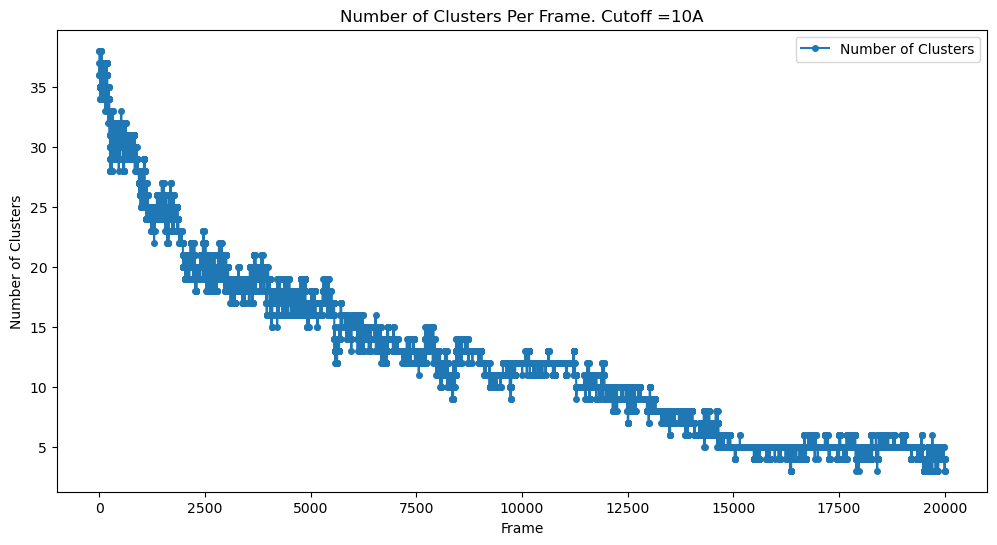

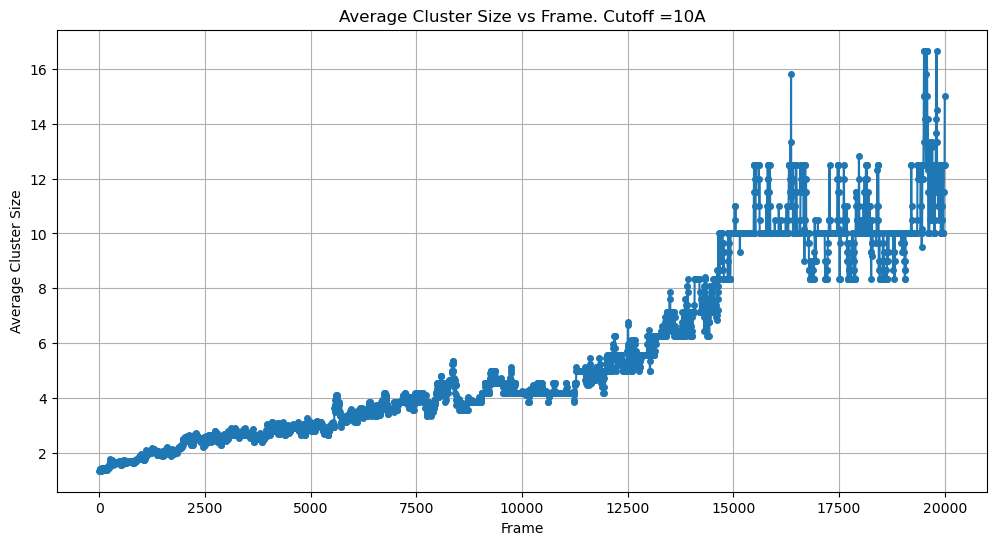

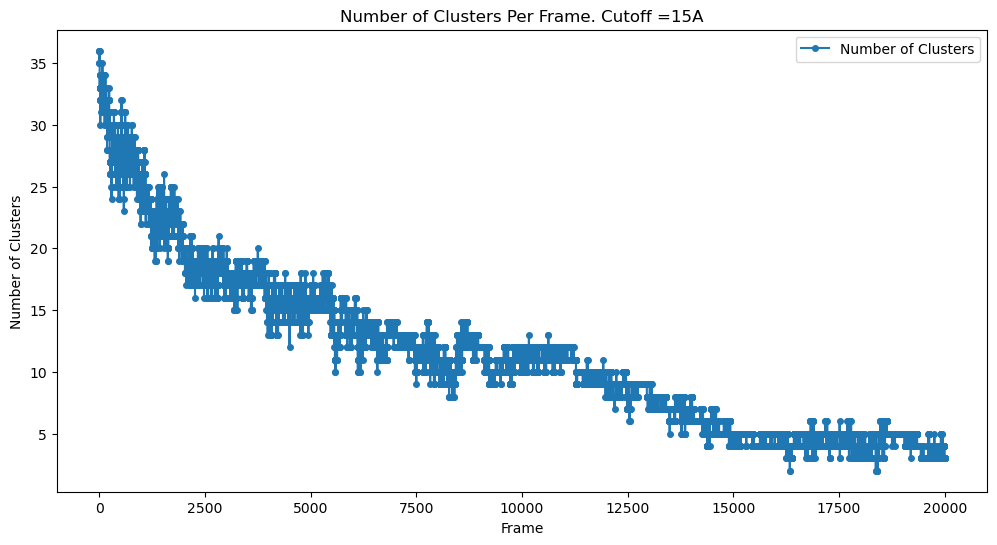

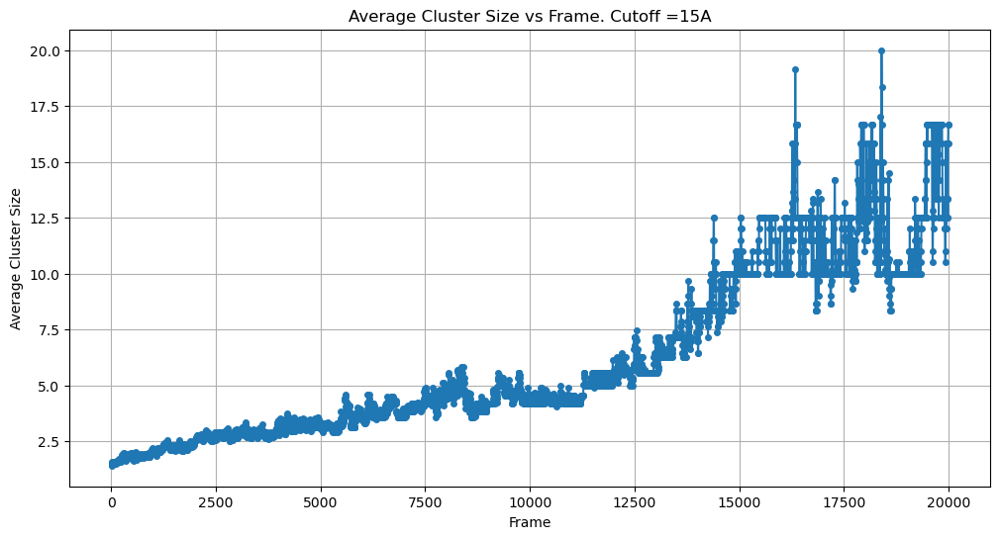

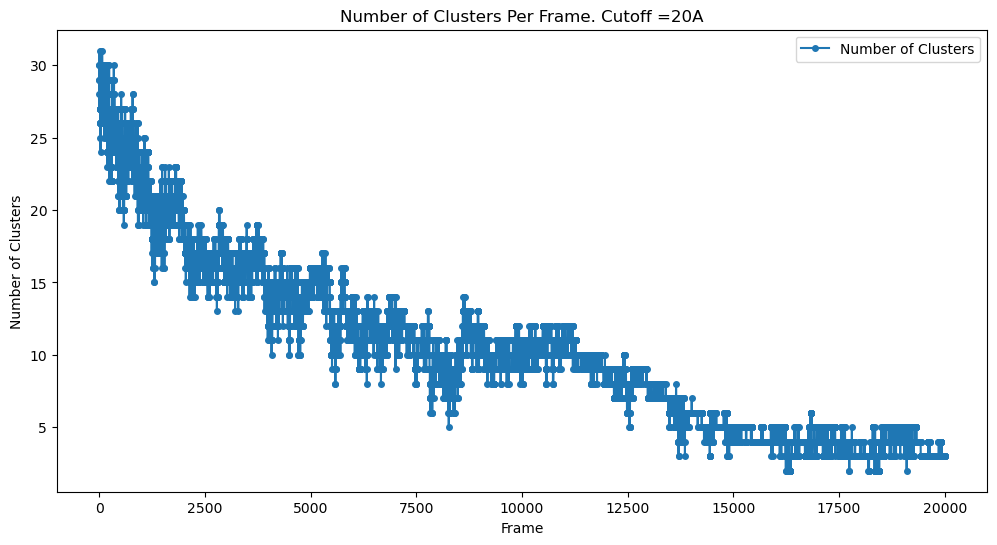

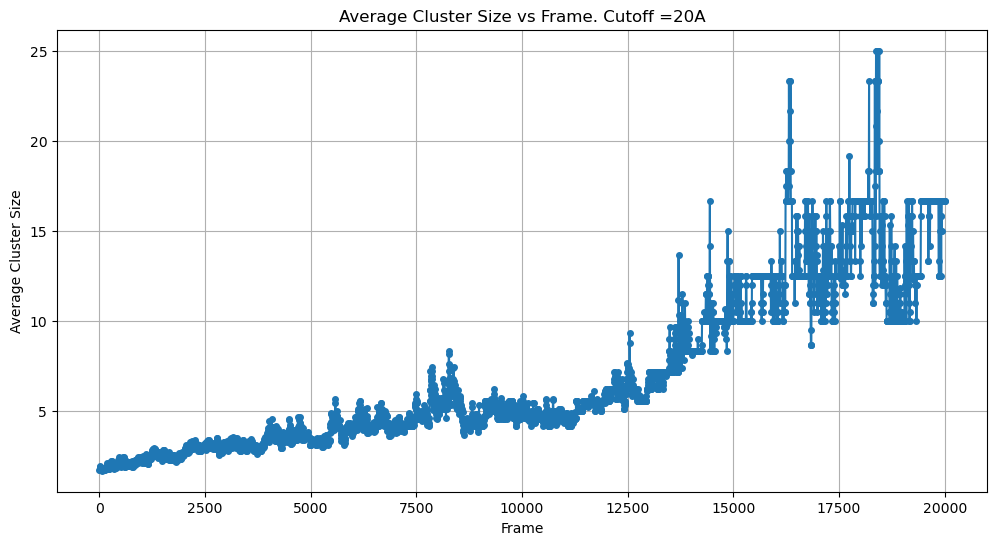

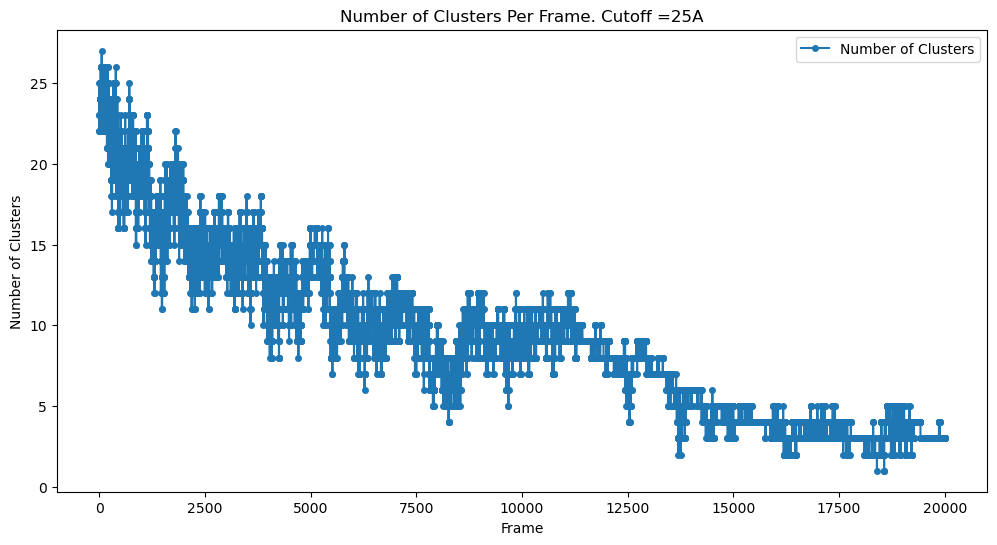

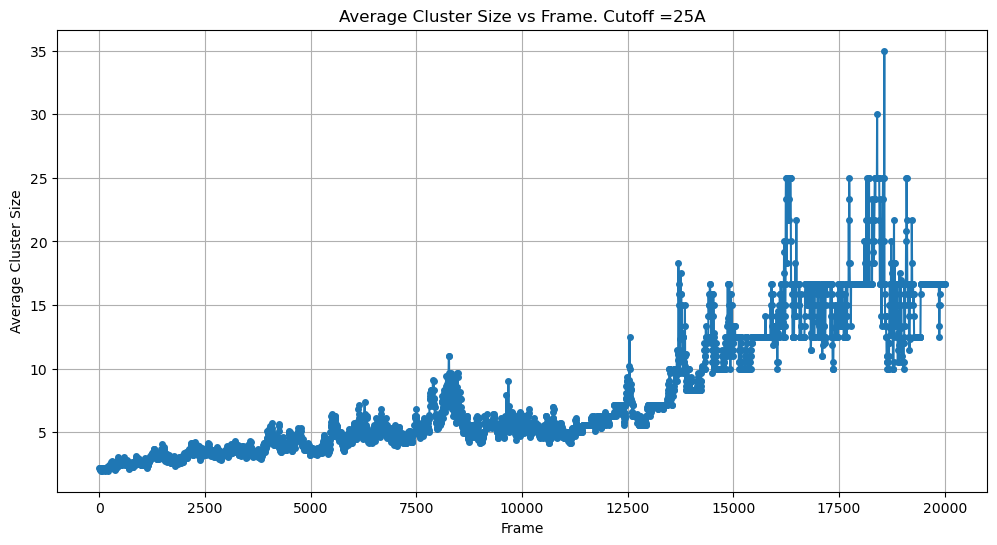

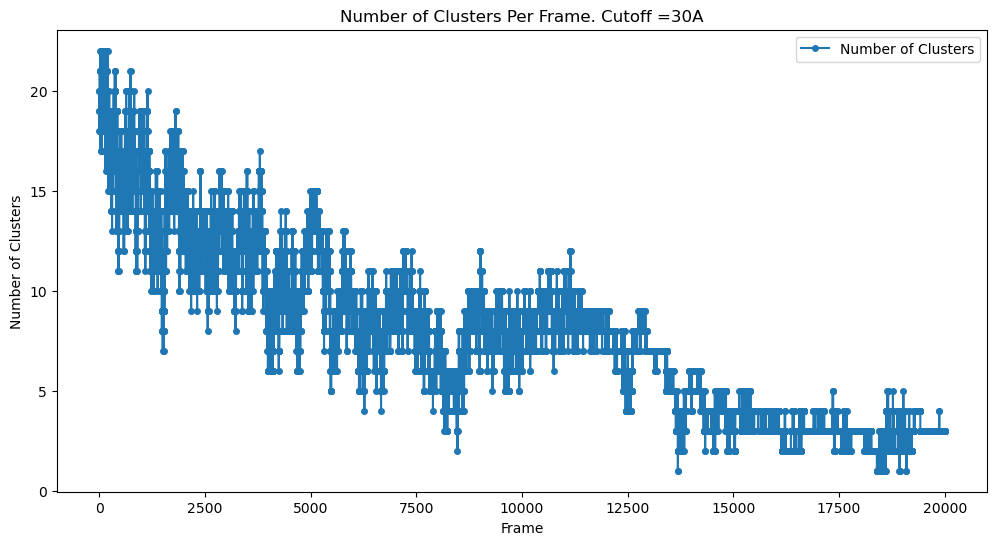

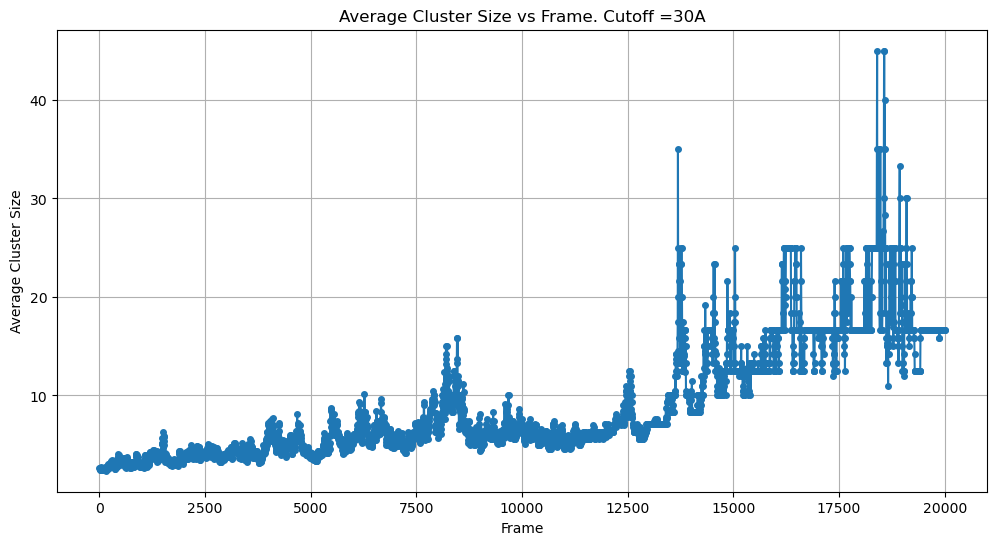

In [10]:
n = 5
for i, clust_per_frame in enumerate(clusts):
    frames = plot_cluster(clust_per_frame, cutoffs[i], n)

In [11]:
clusters_per_frame = clusts[0]
cluster_assignments_per_frame = {}

for frame in frames:
    clusters = clusters_per_frame[frame]  # Retrieve clusters for the current frame
    assignments = {}  # To store cluster assignments for this frame

    for cluster_id, cluster in enumerate(clusters):
        for protein in cluster:
            assignments[protein] = cluster_id  # Assign cluster ID to the protein

    cluster_assignments_per_frame[frame] = assignments
    #print(cluster_assignments_per_frame)

#Example: Print cluster assignments for the first frame
# print("Cluster assignments for Frame 0:")
# for protein, cluster_id in cluster_assignments_per_frame[0].items():
#     print(f"Protein {protein}: Cluster {cluster_id}")

In [12]:

import plotly.graph_objects as go
import matplotlib.pyplot as plt


window_size = n # Adjust this to change the smoothing level

print(coms.shape)
# Create a function to compute averaged positions
def average_positions(coms, frame_idx, window_size):
    start_idx = max(0, frame_idx -  window_size)
    end_idx = min(n_frames, frame_idx)
    return np.mean(coms[start_idx:end_idx], axis=0)

# Example data: Replace with your actual data
# `coms` contains the center of mass positions for each protein in each frame
# `cluster_assignments_per_frame` is your dictionary with cluster assignments
n_frames = len(frames)
n_proteins = len(cluster_assignments_per_frame[n])
print(n_proteins)
print(n_frames)


# Generate a consistent set of colors for clusters
assignments = cluster_assignments_per_frame[n]  # Cluster assignments for this frame
clusters = [assignments[protein] for protein in range(n_proteins)]  # Cluster IDs for all proteins in this frame
n_clusters = np.max(clusters)+1
cluster_colors = plt.cm.tab20(np.linspace(0, 1, n_clusters))

# Create Plotly frames for animation
frames = []
for frame_id in range(1, n_frames):
    frame_idx = frame_id*n
    #print(frame_idx)
    assignments = cluster_assignments_per_frame[frame_idx]  # Cluster assignments for this frame
    clusters = [assignments[protein] for protein in range(n_proteins)]  # Cluster IDs for all proteins in this frame
    n_clusters = np.max(clusters)+1
    cluster_colors = plt.cm.tab20(np.linspace(0, 1, n_clusters))
    cluster_colors = ["rgb({}, {}, {})".format(int(c[0]*255), int(c[1]*255), int(c[2]*255)) for c in cluster_colors]
    
    # Compute averaged positions
    avg_coms = average_positions(coms, frame_idx, window_size)
    scatter = go.Scatter3d(
        x=avg_coms[:, 0],
        y=avg_coms[:, 1],
        z=avg_coms[:, 2],
        mode='markers',
        marker=dict(
            size=4,
            color=[cluster_colors[cluster_id % len(cluster_colors)] for cluster_id in clusters],  # Map clusters to colors
        )
    )
    frames.append(go.Frame(data=[scatter], name=str(frame_idx)))

# Initial frame (first frame)
initial_assignments = cluster_assignments_per_frame[n]
initial_clusters = [initial_assignments[protein] for protein in range(n_proteins)]
initial_scatter = go.Scatter3d(
    x=coms[0, :, 0],
    y=coms[0, :, 1],
    z=coms[0, :, 2],
    mode='markers',
    marker=dict(
        size=4,
        color=[cluster_colors[cluster_id % len(cluster_colors)] for cluster_id in initial_clusters],
    )
)

# Create the figure
fig = go.Figure(
    data=[initial_scatter],
    layout=go.Layout(
        title="Cluster Assignments Over Time",
        scene=dict(
            xaxis_title="X",
            yaxis_title="Y",
            zaxis_title="Z"
        ),
        updatemenus=[dict(
            type="buttons",
            showactive=False,
            buttons=[
                dict(label="Play",
                     method="animate",
                     args=[None, dict(frame=dict(duration=50, redraw=True), fromcurrent=True)]),
                dict(label="Pause",
                     method="animate",
                     args=[[None], dict(frame=dict(duration=0, redraw=False), mode="immediate")])
            ]
        )]
    ),
    frames=frames
)

# Add a slider for interactive navigation
fig.update_layout(
    sliders=[{
        "steps": [
            {
                "args": [[str(frame_idx)], {"frame": {"duration": 50, "redraw": True}, "mode": "immediate"}],
                "label": str(frame_idx*n),
                "method": "animate"
            } for frame_idx in range(1, n_frames-n)
        ],
        "currentvalue": {"prefix": "Frame: "},
    }]
)

# Show the plot
fig.show()

(20001, 50, 3)
50
4000


/opt/conda/envs/gromacs/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/conda/envs/gromacs/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
